In [1]:
import pandas as pd

train = pd.read_csv("../Data/continuous_factory_process.csv")
test = pd.read_csv("../Data/continuous_factory_process.csv")

In [3]:
train.head()

,time_stamp,AmbientConditions.AmbientHumidity.U.Actual,AmbientConditions.AmbientTemperature.U.Actual,Machine1.RawMaterial.Property1,Machine1.RawMaterial.Property2,Machine1.RawMaterial.Property3,Machine1.RawMaterial.Property4,Machine1.RawMaterialFeederParameter.U.Actual,Machine1.Zone1Temperature.C.Actual,Machine1.Zone2Temperature.C.Actual,...,Stage2.Output.Measurement10.U.Actual,Stage2.Output.Measurement10.U.Setpoint,Stage2.Output.Measurement11.U.Actual,Stage2.Output.Measurement11.U.Setpoint,Stage2.Output.Measurement12.U.Actual,Stage2.Output.Measurement12.U.Setpoint,Stage2.Output.Measurement13.U.Actual,Stage2.Output.Measurement13.U.Setpoint,Stage2.Output.Measurement14.U.Actual,Stage2.Output.Measurement14.U.Setpoint
0,2019-03-06 10:52:33,17.24,23.53,11.54,200,963.0,247,1241.26,72.0,72.3,...,0.0,7.93,0.0,5.65,0.0,1.85,0.0,2.89,0.0,11.71
1,2019-03-06 10:52:34,17.24,23.53,11.54,200,963.0,247,1246.09,72.0,72.3,...,0.0,7.93,0.0,5.65,0.0,1.85,0.0,2.89,0.0,11.71
2,2019-03-06 10:52:35,17.24,23.53,11.54,200,963.0,247,1246.29,72.0,72.3,...,0.0,7.93,0.0,5.65,0.0,1.85,0.0,2.89,0.0,11.71
3,2019-03-06 10:52:36,17.24,23.53,11.54,200,963.0,247,1247.59,72.0,72.3,...,0.0,7.93,0.0,5.65,0.0,1.85,0.0,2.89,0.0,11.71
4,2019-03-06 10:52:37,17.24,23.53,11.54,200,963.0,247,1252.83,72.1,72.4,...,0.0,7.93,0.0,5.65,0.0,1.85,0.0,2.89,0.0,11.71


In [3]:
train.shape

(14088, 116)

In [4]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14088 entries, 0 to 14087
Columns: 116 entries, time_stamp to Stage2.Output.Measurement14.U.Setpoint
dtypes: float64(108), int64(7), object(1)
memory usage: 12.5+ MB


In [5]:
train.isnull().sum()

time_stamp                                       0
AmbientConditions.AmbientHumidity.U.Actual       0
AmbientConditions.AmbientTemperature.U.Actual    0
Machine1.RawMaterial.Property1                   0
Machine1.RawMaterial.Property2                   0
                                                ..
Stage2.Output.Measurement12.U.Setpoint           0
Stage2.Output.Measurement13.U.Actual             0
Stage2.Output.Measurement13.U.Setpoint           0
Stage2.Output.Measurement14.U.Actual             0
Stage2.Output.Measurement14.U.Setpoint           0
Length: 116, dtype: int64

In [4]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [5]:
factory_condition = train.iloc[:,1:3]
machine1_raw = train.iloc[:,3:7]
machine1_process = train.iloc[:,7:15]
machine2_raw = train.iloc[:,15:19]
machine2_process = train.iloc[:,19:27]
machine3_raw = train.iloc[:,27:31]
machine3_process = train.iloc[:,31:38]
combine_params = train.iloc[:,39:42]
primary_output = train.iloc[:,42:72]
machine4_process = train.iloc[:,72:79]
machine5_process = train.iloc[:,79:86]
secondary_output = train.iloc[:,86:]

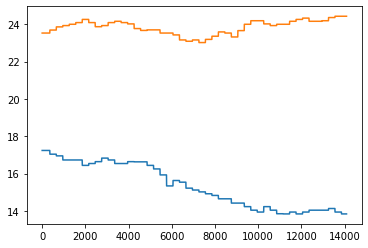

In [6]:
fig = plt.figure()
ax = fig.add_subplot(1,1,1)
ax.plot(factory_condition)

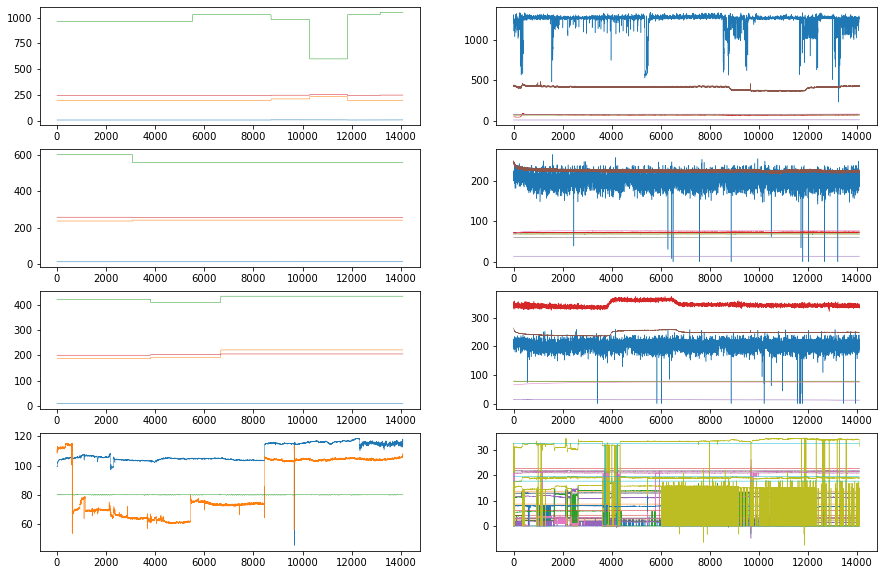

In [7]:
var1 = [
    machine1_raw,
    machine1_process,
    machine2_raw,
    machine2_process,
    machine3_raw,
    machine3_process,
    combine_params,
    primary_output
    ]
fig = plt.figure(figsize=[15,10])
for i in range(1, 9):
    ax = fig.add_subplot(4, 2, i)
    ax.plot(var1[i - 1], linewidth = 0.5)

<AxesSubplot:>

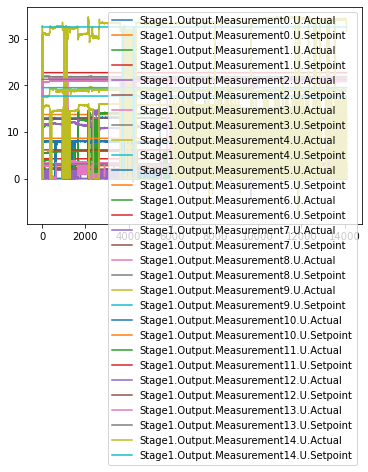

In [10]:
primary_output.plot()

In [8]:
actual_index = [i * 2 for i in range(15)]
setpoint_index = [i * 2 + 1 for i in range(15)]
primary_output_actual = primary_output.iloc[:,actual_index]
primary_output_setpoint = primary_output.iloc[:,setpoint_index]

<AxesSubplot:>

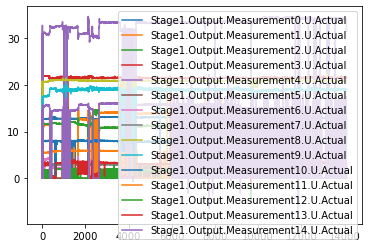

In [12]:
primary_output_actual.plot()

<AxesSubplot:>

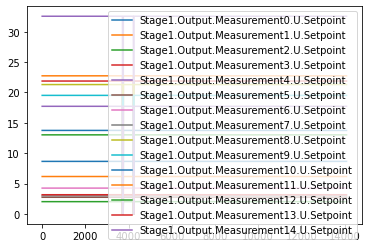

In [13]:
primary_output_setpoint.plot()

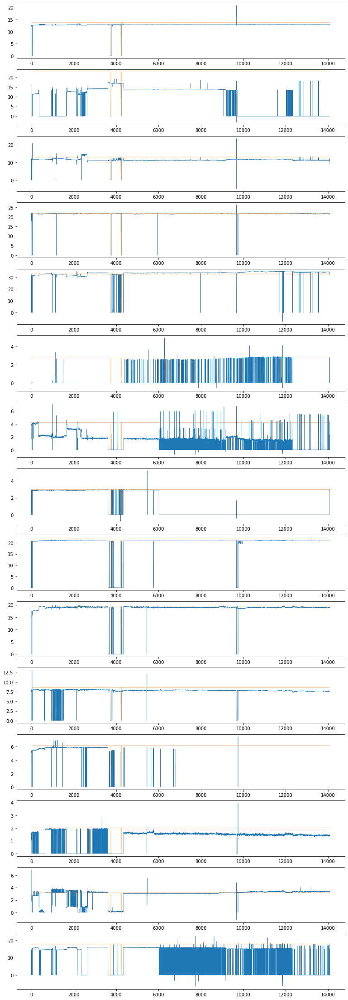

In [14]:
fig = plt.figure(figsize = [13,40])
for i in range(1, 16):
    ax = fig.add_subplot(15, 1, i)
    ax.plot(pd.concat([primary_output_actual.iloc[:,i - 1], primary_output_setpoint.iloc[:,i - 1]], axis = 1),
        linewidth=0.5)

In [15]:
combine_params.info()
combine_params.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14088 entries, 0 to 14087
Data columns (total 3 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   FirstStage.CombinerOperation.Temperature1.U.Actual  14088 non-null  float64
 1   FirstStage.CombinerOperation.Temperature2.U.Actual  14088 non-null  float64
 2   FirstStage.CombinerOperation.Temperature3.C.Actual  14088 non-null  float64
dtypes: float64(3)
memory usage: 330.3 KB


,FirstStage.CombinerOperation.Temperature1.U.Actual,FirstStage.CombinerOperation.Temperature2.U.Actual,FirstStage.CombinerOperation.Temperature3.C.Actual
0,99.1,108.2,80.0
1,99.1,109.2,80.0
2,99.6,111.0,80.0
3,99.6,109.2,80.0
4,99.6,109.8,80.0


In [16]:
primary_output.info()
primary_output.describe()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14088 entries, 0 to 14087
Data columns (total 30 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   Stage1.Output.Measurement0.U.Actual     14088 non-null  float64
 1   Stage1.Output.Measurement0.U.Setpoint   14088 non-null  float64
 2   Stage1.Output.Measurement1.U.Actual     14088 non-null  float64
 3   Stage1.Output.Measurement1.U.Setpoint   14088 non-null  float64
 4   Stage1.Output.Measurement2.U.Actual     14088 non-null  float64
 5   Stage1.Output.Measurement2.U.Setpoint   14088 non-null  float64
 6   Stage1.Output.Measurement3.U.Actual     14088 non-null  float64
 7   Stage1.Output.Measurement3.U.Setpoint   14088 non-null  float64
 8   Stage1.Output.Measurement4.U.Actual     14088 non-null  float64
 9   Stage1.Output.Measurement4.U.Setpoint   14088 non-null  float64
 10  Stage1.Output.Measurement5.U.Actual     14088 non-null  fl

,Stage1.Output.Measurement0.U.Actual,Stage1.Output.Measurement0.U.Setpoint,Stage1.Output.Measurement1.U.Actual,Stage1.Output.Measurement1.U.Setpoint,Stage1.Output.Measurement2.U.Actual,Stage1.Output.Measurement2.U.Setpoint,Stage1.Output.Measurement3.U.Actual,Stage1.Output.Measurement3.U.Setpoint,Stage1.Output.Measurement4.U.Actual,Stage1.Output.Measurement4.U.Setpoint,...,Stage1.Output.Measurement10.U.Actual,Stage1.Output.Measurement10.U.Setpoint,Stage1.Output.Measurement11.U.Actual,Stage1.Output.Measurement11.U.Setpoint,Stage1.Output.Measurement12.U.Actual,Stage1.Output.Measurement12.U.Setpoint,Stage1.Output.Measurement13.U.Actual,Stage1.Output.Measurement13.U.Setpoint,Stage1.Output.Measurement14.U.Actual,Stage1.Output.Measurement14.U.Setpoint
count,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000,...,14088.000000,14088.000000,1.408800e+04,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000,14088.000000
mean,12.896919,13.695344,8.050511,22.649608,11.357154,12.968245,21.325946,21.793027,32.876441,32.420613,...,7.681824,8.615616,1.492745e+00,6.135514,1.202880,2.011970,2.881181,3.147439,9.940519,17.649563
std,0.934228,0.865212,6.904337,1.430903,1.052791,0.819277,2.110456,1.376788,3.869849,2.048193,...,1.085486,0.544297,2.542739e+00,0.387615,0.663677,0.127108,0.941027,0.198841,7.416543,1.115022
min,0.000000,0.000000,-3.132803,0.000000,-4.927832,0.000000,0.000000,0.000000,-7.688987,0.000000,...,-0.001439,0.000000,-1.633650e-20,0.000000,-0.000356,0.000000,-1.225095,0.000000,-6.548924,0.000000
25%,12.890000,13.750000,0.000000,22.740000,11.200000,13.020000,21.480000,21.880000,33.240000,32.550000,...,7.730000,8.650000,0.000000e+00,6.160000,1.390000,2.020000,3.020000,3.160000,0.000000,17.720000
50%,12.970000,13.750000,13.250000,22.740000,11.310000,13.020000,21.510000,21.880000,33.460000,32.550000,...,7.840000,8.650000,0.000000e+00,6.160000,1.500000,2.020000,3.180000,3.160000,15.030000,17.720000
75%,13.050000,13.750000,13.870000,22.740000,11.520000,13.020000,21.550000,21.880000,34.070000,32.550000,...,7.920000,8.650000,5.410000e+00,6.160000,1.570000,2.020000,3.320000,3.160000,15.760000,17.720000
max,20.880000,13.750000,19.140000,22.740000,23.530000,13.020000,26.240000,21.880000,34.760000,32.550000,...,13.070000,8.650000,7.470000e+00,6.160000,3.950000,2.020000,6.910000,3.160000,22.301788,17.720000


In [17]:
for i in var1:
    i.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14088 entries, 0 to 14087
Data columns (total 4 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Machine1.RawMaterial.Property1  14088 non-null  float64
 1   Machine1.RawMaterial.Property2  14088 non-null  int64  
 2   Machine1.RawMaterial.Property3  14088 non-null  float64
 3   Machine1.RawMaterial.Property4  14088 non-null  int64  
dtypes: float64(2), int64(2)
memory usage: 440.4 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14088 entries, 0 to 14087
Data columns (total 8 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   Machine1.RawMaterialFeederParameter.U.Actual  14088 non-null  float64
 1   Machine1.Zone1Temperature.C.Actual            14088 non-null  float64
 2   Machine1.Zone2Temperature.C.Actual            14088 non-null 

In [18]:
combine_params_actual = pd.concat([combine_params, primary_output_actual], axis = 1)
combine_params_actual.head()


,FirstStage.CombinerOperation.Temperature1.U.Actual,FirstStage.CombinerOperation.Temperature2.U.Actual,FirstStage.CombinerOperation.Temperature3.C.Actual,Stage1.Output.Measurement0.U.Actual,Stage1.Output.Measurement1.U.Actual,Stage1.Output.Measurement2.U.Actual,Stage1.Output.Measurement3.U.Actual,Stage1.Output.Measurement4.U.Actual,Stage1.Output.Measurement5.U.Actual,Stage1.Output.Measurement6.U.Actual,Stage1.Output.Measurement7.U.Actual,Stage1.Output.Measurement8.U.Actual,Stage1.Output.Measurement9.U.Actual,Stage1.Output.Measurement10.U.Actual,Stage1.Output.Measurement11.U.Actual,Stage1.Output.Measurement12.U.Actual,Stage1.Output.Measurement13.U.Actual,Stage1.Output.Measurement14.U.Actual
0,99.1,108.2,80.0,12.72,0.0,12.16,21.97,0.00,0.0,3.82,2.94,20.82,17.30,8.06,5.54,1.66,2.69,14.51
1,99.1,109.2,80.0,12.34,0.0,0.00,17.78,0.00,0.0,3.97,0.00,19.65,17.31,7.55,5.13,1.04,2.70,0.00
2,99.6,111.0,80.0,12.34,0.0,0.00,17.78,0.00,0.0,3.97,0.00,19.65,17.31,7.55,5.13,1.04,2.70,0.00
3,99.6,109.2,80.0,12.34,0.0,0.00,17.78,0.00,0.0,3.97,0.00,19.65,17.31,7.55,5.13,1.04,2.70,0.00
4,99.6,109.8,80.0,12.29,0.0,0.00,17.83,31.44,0.0,3.87,0.00,0.00,17.30,7.54,5.15,1.15,2.72,0.00


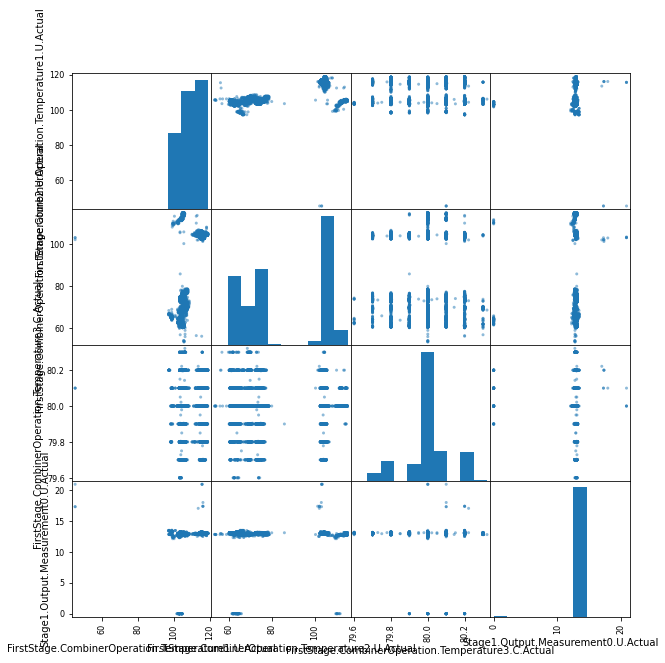

In [21]:
for i in range(15):
    pd.plotting.scatter_matrix(
        combine_params_actual.iloc[:,[0, 1, 2, 3 + i]],
        alpha = 0.5,
        figsize= (10, 10),
        diagonal = 'hist'
        )
    plt.show()

In [1]:
machine1_process_actual = pd.concat([machine1_process, primary_output_actual], axis = 1)
machine1_process_actual.head()

NameError: name 'pd' is not defined

In [ ]:
for i in range(15):
    pd.plotting.scatter_matrix(
        machine1_process_actual.iloc[:,[0, 1, 2, 3, 4, 5, 6, 7, 8 + i]],
        alpha = 0.5,
        figsize= (10, 10),
        diagonal = 'hist'
        )
    plt.show()

In [ ]:
machine2_process_actual = pd.concat([machine2_process, primary_output_actual], axis = 1)
machine2_process_actual.head()

In [ ]:
for i in range(15):
    pd.plotting.scatter_matrix(
        machine2_process_actual.iloc[:,[0, 1, 2, 3, 4, 5, 6, 7, 8 + i]],
        alpha = 0.5,
        figsize= (10, 10),
        diagonal = 'hist'
        )
    plt.show()

In [ ]:
machine3_process_actual = pd.concat([machine3_process, primary_output_actual], axis = 1)
machine3_process_actual.head()

In [ ]:
for i in range(15):
    pd.plotting.scatter_matrix(
        machine3_process_actual.iloc[:,[0, 1, 2, 3, 4, 5, 6, 7, 8 + i]],
        alpha = 0.5,
        figsize= (10, 10),
        diagonal = 'hist'
        )
    plt.show()